# Visualize Cytomining Ecosystem Software Landscape

Visualizations related to Cytomining ecosystem software landscape analysis.

## Plot Foci

- User base size
- Usage
- Maturity

In [1]:
import asyncio
import itertools
import os
import pathlib
import random
from datetime import datetime

import nest_asyncio
import numpy as np
import pandas as pd
import plotly.colors as pc
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
import pytz
from box import Box
from itables import to_html_datatable
from plotly.offline import plot
from plotly.subplots import make_subplots
from pyppeteer import launch
from ydata_profiling import ProfileReport

# set plotly default theme
pio.templates.default = "simple_white"

# get the current datetime
tz = pytz.timezone("UTC")
current_datetime = datetime.now(tz)

# set common str's
title_prefix = "Cytomining Ecosystem Software Landscape Analysis"

# export locations relative to this notebook
export_dir = "../../docs/cytomining-ecosystem"

# set the color sequence for category-based charts
category_color_sequence = pc.qualitative.T10[:5]

# set section descriptions
section_descriptions = {
    "User base": """
    This section helps visualize the relative user base size and age of projects.
    """,
    "Maturity": """
    This section seeks to demonstrate relative project maturity by leveraging age,
    relative activity, GitHub stars, and total lines of code.
    """,
    "Usage": """
    This section portrays relative project usage through GitHub watchers, forks, contributor and issue counts.
    """,
    "General landscape": """
    This section visualizes broader aspects of the software landscape such as primary language preference and
    GitHub organization metrics.
    """,
}

In [2]:
# read in project metric data
df_projects = pd.read_parquet("data/project-github-metrics.parquet")
df_projects = df_projects.reset_index(drop=True)
df_projects.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1123 entries, 0 to 1122
Data columns (total 25 columns):
 #   Column                                       Non-Null Count  Dtype              
---  ------                                       --------------  -----              
 0   Project Name                                 1123 non-null   object             
 1   GitHub Repository ID                         1123 non-null   int64              
 2   Project Homepage                             584 non-null    object             
 3   Project Repo URL                             1123 non-null   object             
 4   Project Landscape Category                   1123 non-null   object             
 5   GitHub Stars                                 1123 non-null   int64              
 6   GitHub Forks                                 1123 non-null   int64              
 7   GitHub Subscribers                           1123 non-null   int64              
 8   GitHub Open Issues          

In [3]:
# set a category column to the first category from a potential list of categories
df_projects["category"] = df_projects["Project Landscape Category"].str[0]
# remove prefix from certain categories for brevity
df_projects["category"] = (
    df_projects["category"]
    .str.replace("cytomining-ecosystem-", "")
    .str.replace("related-tools-", "")
)
df_projects.head(5)

,Project Name,GitHub Repository ID,Project Homepage,Project Repo URL,Project Landscape Category,GitHub Stars,GitHub Forks,GitHub Subscribers,GitHub Open Issues,GitHub Contributors,...,Date Created,Date Most Recent Commit,Duration Created to Most Recent Commit,Duration Created to Now,Duration Most Recent Commit to Now,Repository Size (KB),GitHub Repo Archived,Duration Created to Now in Years,Negative Duration Most Recent Commit to Now,category
0,pandas,858127,https://pandas.pydata.org,https://github.com/pandas-dev/pandas,[cytomining-ecosystem-relevant-open-source],40031,16810,1121,3656,411,...,2010-08-24 01:37:33+00:00,2023-10-16 16:52:20+00:00,4801 days 15:14:47,4801 days 15:45:14.559263,0 days 00:30:27.559263,334787,False,13.153425,-1 days +23:29:32.440737,relevant-open-source
1,numpy,908607,https://numpy.org,https://github.com/numpy/numpy,[cytomining-ecosystem-relevant-open-source],24741,8647,595,2193,435,...,2010-09-13 23:02:39+00:00,2023-10-16 14:25:39+00:00,4780 days 15:23:00,4780 days 18:20:08.559263,0 days 02:57:08.559263,131902,False,13.095890,-1 days +21:02:51.440737,relevant-open-source
2,arrow,51905353,https://arrow.apache.org/,https://github.com/apache/arrow,[cytomining-ecosystem-relevant-open-source],12614,3096,351,3908,367,...,2016-02-17 08:00:23+00:00,2023-10-16 17:18:03+00:00,2798 days 09:17:40,2798 days 09:22:24.559263,0 days 00:04:44.559263,171101,False,7.665753,-1 days +23:55:15.440737,relevant-open-source
3,duckdb,138754790,http://www.duckdb.org,https://github.com/duckdb/duckdb,[cytomining-ecosystem-relevant-open-source],12393,1157,157,309,253,...,2018-06-26 15:04:45+00:00,2023-10-16 14:58:09+00:00,1937 days 23:53:24,1938 days 02:18:02.559263,0 days 02:24:38.559263,227662,False,5.309589,-1 days +21:35:21.440737,relevant-open-source
4,parquet-mr,20675636,,https://github.com/apache/parquet-mr,[cytomining-ecosystem-relevant-open-source],2179,1332,95,130,190,...,2014-06-10 07:00:07+00:00,2023-10-16 15:19:17+00:00,3415 days 08:19:10,3415 days 10:22:40.559263,0 days 02:03:30.559263,18475,False,9.356164,-1 days +21:56:29.440737,relevant-open-source


In [4]:
# create list to collect the figures for later display together
fig_collection = []

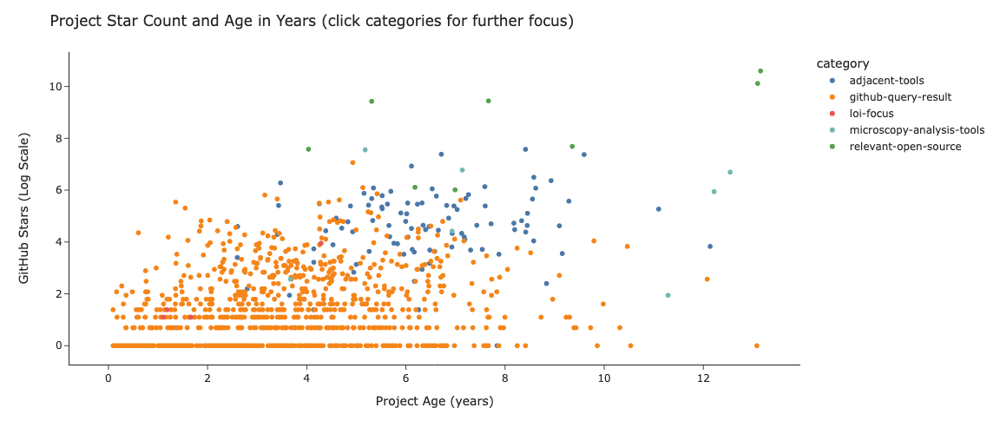

In [5]:
# Github stars and time scatter

# add log of github stars to help visualize
df_projects["GitHub Stars (Log Scale)"] = np.log(
    df_projects["GitHub Stars"].apply(
        # move 0's to None to avoid divide by 0
        lambda x: x
        if x > 0
        else None
    )
)

fig_usage_stars = px.scatter(
    df_projects.sort_values(by="category"),
    hover_name="Project Name",
    x="Duration Created to Now in Years",
    y="GitHub Stars (Log Scale)",
    width=1200,
    height=500,
    color="category",
    color_discrete_sequence=category_color_sequence,
)


# customize the chart layout
fig_usage_stars.update_layout(
    title=f"Project Star Count and Age in Years (click categories for further focus)",
    xaxis_title="Project Age (years)",
    yaxis_title="GitHub Stars (Log Scale)",
)

fig_collection.append(
    {
        "plot": fig_usage_stars,
        "description": """
        This plot explores the user bases of relevant projects
        through relative GitHub stars and the age of the project in years.
        GitHub stars is an indication of unique users whom are interested
        in and likely use the project somehow.
        """,
        "findings": """
        We observe that projects of greater age are not always those with the most stars.
        Projects of <code>loi-focus</code> category are generally
        in an early state of their user base (both in age and stars),
        relative to other projects.
        """,
        "section": "User base",
    }
)

fig_usage_stars.show()

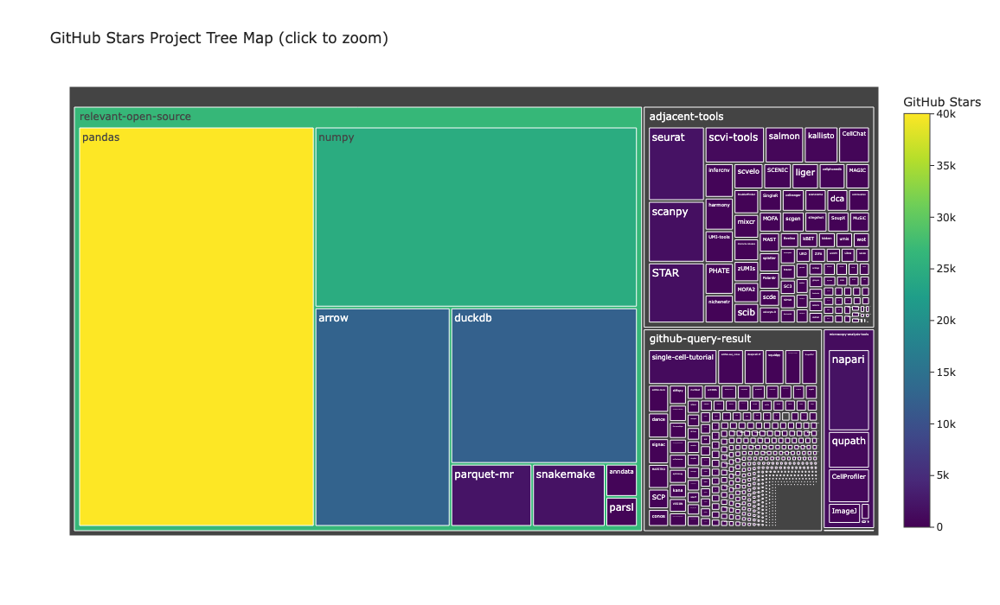

In [6]:
# Create an icicle chart using Plotly Express
df_treemap = df_projects.copy()
df_treemap["GitHub Stars"] = np.where(
    df_treemap["GitHub Stars"] == 0, np.nan, df_treemap["GitHub Stars"]
)
fig_usage_stars_treemap = px.treemap(
    df_treemap.sort_values(by="category"),
    title="GitHub Stars Project Tree Map (click to zoom)",
    path=["category", "Project Name"],
    values="GitHub Stars",
    color="GitHub Stars",
    color_continuous_scale="Viridis",
    width=1200,
    height=700,
)

fig_collection.append(
    {
        "plot": fig_usage_stars_treemap,
        "description": """
        This plot demonstrates the magnitude of total GitHub stars by project and category.
        Click the category boxes to zoom into focus on only those projects.
        """,
        "findings": """
        Here we can see relevant open source far outsize other categories.
        Within the microscopy analysis tools category we can observe that Napari has many more stars than others.
        Projects of <code>loi-focus</code> are nearly invisible in comparison to other projects with
        much greater age.
        """,
        "section": "User base",
    }
)

# Show the icicle chart
fig_usage_stars_treemap.show()

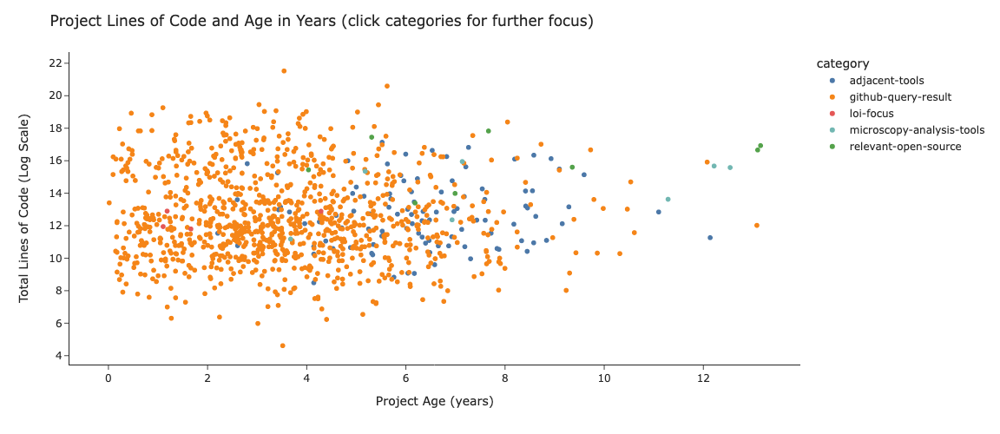

In [7]:
# scatter plot for maturity based on project

# gather the number of lines of code
df_projects["total lines of GitHub detected code"] = (
    df_projects["GitHub Detected Languages"]
    .dropna()
    .apply(lambda x: sum(value if value is not None else 0 for value in x.values()))
)

# add log of github stars to help visualize
df_projects["total lines of GitHub detected code (Log Scale)"] = np.log(
    df_projects["total lines of GitHub detected code"].apply(
        # move 0's to None to avoid divide by 0
        lambda x: x
        if x > 0
        else None
    )
)


fig_maturity_loc_and_age = px.scatter(
    df_projects.sort_values(by="category"),
    hover_name="Project Name",
    x="Duration Created to Now in Years",
    y="total lines of GitHub detected code (Log Scale)",
    width=1200,
    height=500,
    color="category",
    color_discrete_sequence=category_color_sequence,
)


# customize the chart layout
fig_maturity_loc_and_age.update_layout(
    title=f"Project Lines of Code and Age in Years (click categories for further focus)",
    yaxis_title="Total Lines of Code (Log Scale)",
    xaxis_title="Project Age (years)",
)

fig_collection.append(
    {
        "plot": fig_maturity_loc_and_age,
        "description": """
        This plot shows the lines of code (LoC) and age in years to help indicate relative project maturity.
        Lines of code in this case are the sum total of GitHub detected programming language dialects.
        """,
        "findings": """
        We can observe that many tools within the Cytomining Ecosystem landscape reside within a certain range
        of total LoC and that projects of greater age do not necessarily have more code.
        Tools of <code>loi-focus</code> are nearby the LoC of other tools with greater age.
        """,
        "section": "Maturity",
    }
)

fig_maturity_loc_and_age.show()

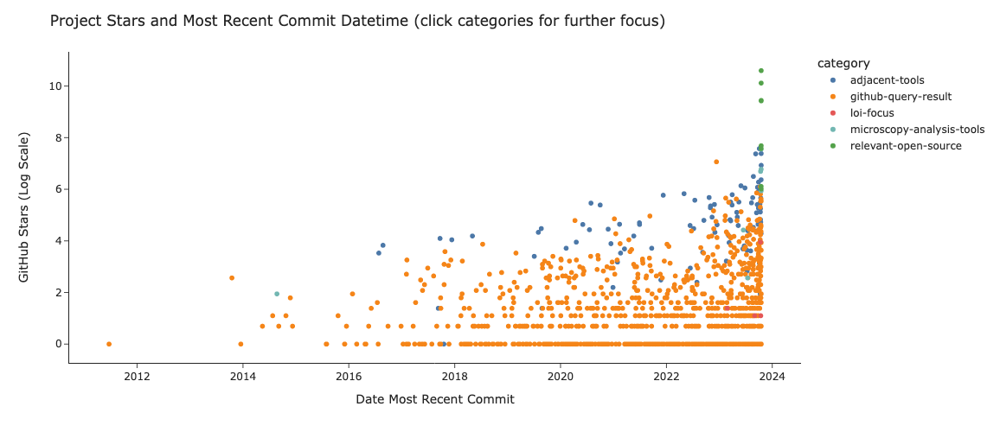

In [8]:
# scatter plot for maturity based on project

# add log of github stars to help visualize
"""df_projects["GitHub Open Issues (Log Scale)"] = np.log(
    df_projects["GitHub Open Issues"].apply(
        # move 0's to None to avoid divide by 0
        lambda x: x
        if x > 0
        else None
    )
)
"""

fig_maturity_latest_commit = px.scatter(
    df_projects.sort_values(by="category"),
    hover_name="Project Name",
    x="Date Most Recent Commit",
    y="GitHub Stars (Log Scale)",
    width=1200,
    height=500,
    color="category",
    color_discrete_sequence=category_color_sequence,
)


# customize the chart layout
fig_maturity_latest_commit.update_layout(
    title=f"Project Stars and Most Recent Commit Datetime (click categories for further focus)",
)

fig_collection.append(
    {
        "plot": fig_maturity_latest_commit,
        "description": """
        This plot demonstrates project GitHub stars and most recent commit datetime as a way to observe
        potential decay for projects which may have been popular at one point but are no longer maintained.
        """,
        "findings": """
        We find that relevant open source, microscopy analysis tools, and tools of <code>loi-focus</code> are
        all recently updated. Adjacent tools demonstrate historical usage but are somewhat less frequently maintained.
        Many tools from GitHub queries show a lack of updates for greater than 2 years.
        """,
        "section": "Maturity",
    }
)

fig_maturity_latest_commit.show()

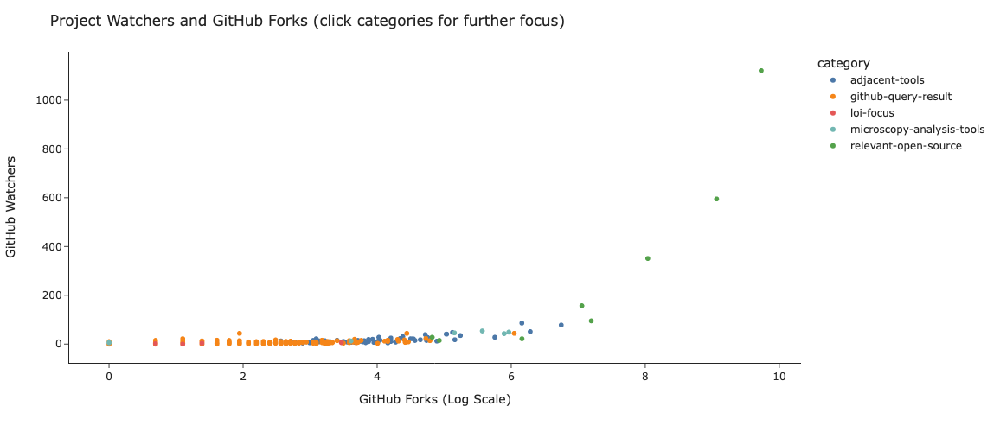

In [9]:
# scatter plot for network and subscribers

# add log of github stars to help visualize
df_projects["GitHub Forks (Log Scale)"] = np.log(
    df_projects["GitHub Forks"].apply(
        # move 0's to None to avoid divide by 0
        lambda x: x
        if x > 0
        else None
    )
)

fig_network_and_subscribers = px.scatter(
    df_projects.sort_values(by="category"),
    hover_name="Project Name",
    x="GitHub Forks (Log Scale)",
    y="GitHub Subscribers",
    width=1200,
    height=500,
    color="category",
    color_discrete_sequence=category_color_sequence,
)


# customize the chart layout
fig_network_and_subscribers.update_layout(
    title=f"Project Watchers and GitHub Forks (click categories for further focus)",
    xaxis_title="GitHub Forks (Log Scale)",
    yaxis_title="GitHub Watchers",
)

fig_collection.append(
    {
        "plot": fig_network_and_subscribers,
        "description": """
        This plot shows project GitHub watcher and GitHub fork count
        as a way to demonstrate relative usage.
        """,
        "findings": """
        We can see a wide variety of project watcher and fork count depending on the category involved.
        Generally, projects of <code>loi-focus</code> are at an earlier stage and thus have fewer forks and watchers.
        """,
        "section": "Usage",
    }
)

fig_network_and_subscribers.show()

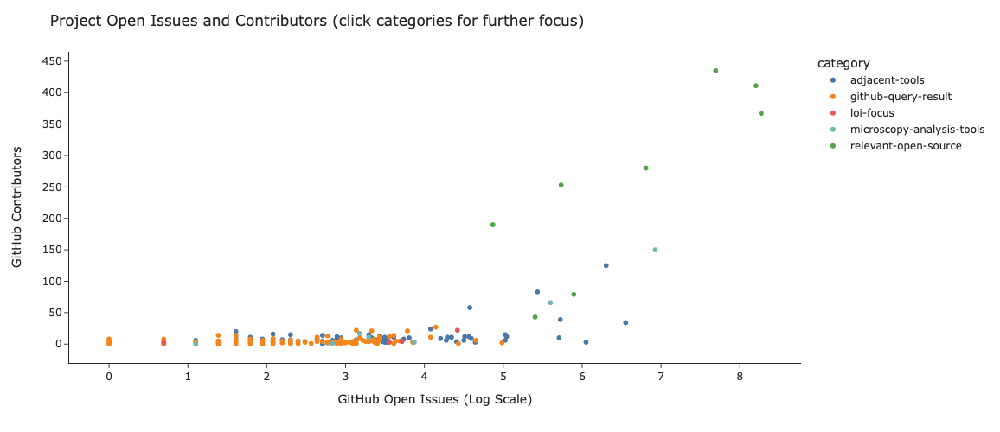

In [10]:
# scatter plot for contributors and issues

# add log of github stars to help visualize
df_projects["GitHub Open Issues (Log Scale)"] = np.log(
    df_projects["GitHub Open Issues"].apply(
        # move 0's to None to avoid divide by 0
        lambda x: x
        if x > 0
        else None
    )
)


fig_contributors_and_issues = px.scatter(
    df_projects.sort_values(by="category"),
    hover_name="Project Name",
    x="GitHub Open Issues (Log Scale)",
    y="GitHub Contributors",
    width=1200,
    height=500,
    color="category",
    color_discrete_sequence=category_color_sequence,
)


# customize the chart layout
fig_contributors_and_issues.update_layout(
    title=f"Project Open Issues and Contributors (click categories for further focus)",
)

fig_collection.append(
    {
        "plot": fig_contributors_and_issues,
        "description": """
        This plot shows the number of project contributors and issue counts as a way to describe usage through maintainability.
        """,
        "findings": """
        We find that many projects have a high contributor and issue count.
        A few Cytomining Ecosystem adjacent and microscopy analysis tools appear to be on a trend towards
        relevant open source tools.
        Projects of <code>loi-focus</code> are nearby many landscape neighbors in the middle of this plot.
        """,
        "section": "Usage",
    }
)

fig_contributors_and_issues.show()

In [11]:
# Function to find the top language for each row
def find_top_language(languages):
    if isinstance(languages, dict):
        non_empty_languages = {
            key: value for key, value in languages.items() if value is not None
        }
        if non_empty_languages:
            return max(non_empty_languages, key=non_empty_languages.get)
    return None


# Apply the function to the "GitHub Detected Languages" column and create a new column "Primary programming language"
df_projects["Primary language"] = df_projects["GitHub Detected Languages"].apply(
    find_top_language
)
df_projects[["Project Name", "Primary language"]]

,Project Name,Primary language
0,pandas,Python
1,numpy,Python
2,arrow,C++
3,duckdb,C++
4,parquet-mr,Java
...,...,...
1118,ImagingCells,Jupyter Notebook
1119,course-bia,Python
1120,Cell-virulence-Detection-using-Image-Processing,Python
1121,Image-analysis,MATLAB


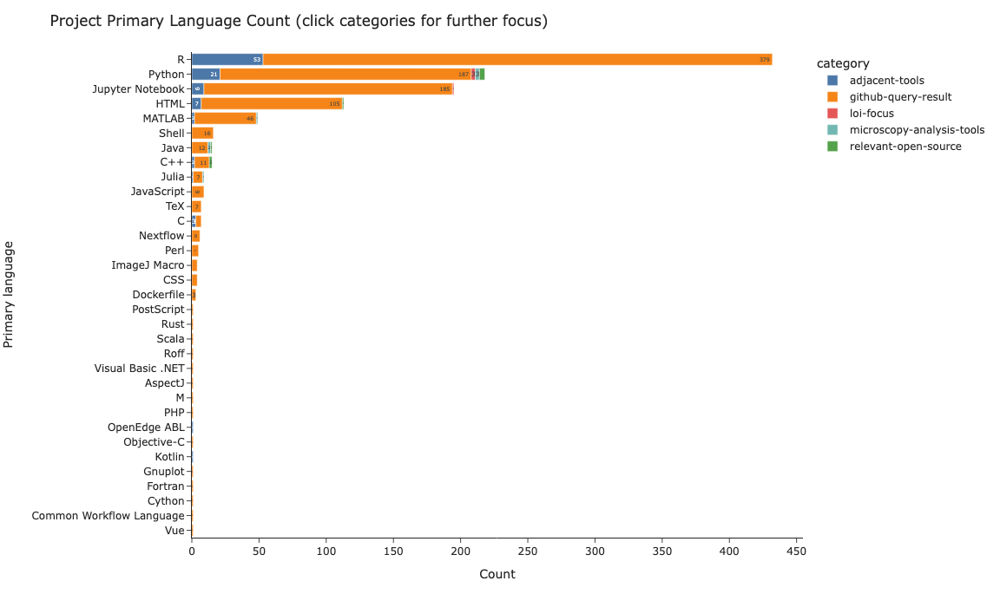

In [12]:
# Create a hbar chart for primary languages
grouped_data = (
    df_projects.groupby(["Primary language", "category"])
    .size()
    .reset_index(name="Count")
)

# Group by "Primary programming language" and calculate the sum of counts for each programming language
programming_language_counts = (
    grouped_data.groupby("Primary language")["Count"].sum().reset_index()
)

# Sort programming languages by the sum of counts in descending order
programming_language_counts = programming_language_counts.sort_values(
    by="Count", ascending=False
)

# Create a horizontal bar chart using Plotly Express
fig_languages = px.bar(
    grouped_data.sort_values(by="category"),
    y="Primary language",
    x="Count",
    color="category",
    color_discrete_sequence=category_color_sequence,
    text="Count",
    orientation="h",
    # Sort bars by programming language counts
    category_orders={
        "Primary language": programming_language_counts["Primary language"].tolist()
    },
    width=1200,
    height=700,
)

# Customize layout to display count labels properly
fig_languages.update_traces(
    texttemplate="%{text}",
    textposition="inside",
)
fig_languages.update_layout(
    title=f"Project Primary Language Count (click categories for further focus)",
    # ensure all y axis labels appear
    yaxis=dict(
        tickmode="array",
        tickvals=programming_language_counts["Primary language"].tolist(),
        ticktext=programming_language_counts["Primary language"].tolist(),
    ),
)

fig_collection.append(
    {
        "plot": fig_languages,
        "description": """
        This plot shows the primary programming language project count colored by category.
        A primary programming language is derived from the maximum lines of code from GitHub-detected programming languages.
        """,
        "findings": """
        We observe that R, Python, and Jupyter Notebooks are among the most popular primary programming languages found
        within the Cytomining Ecosystem software landscape.
        """,
        "section": "General landscape",
    }
)

# Show the plot
fig_languages.show()

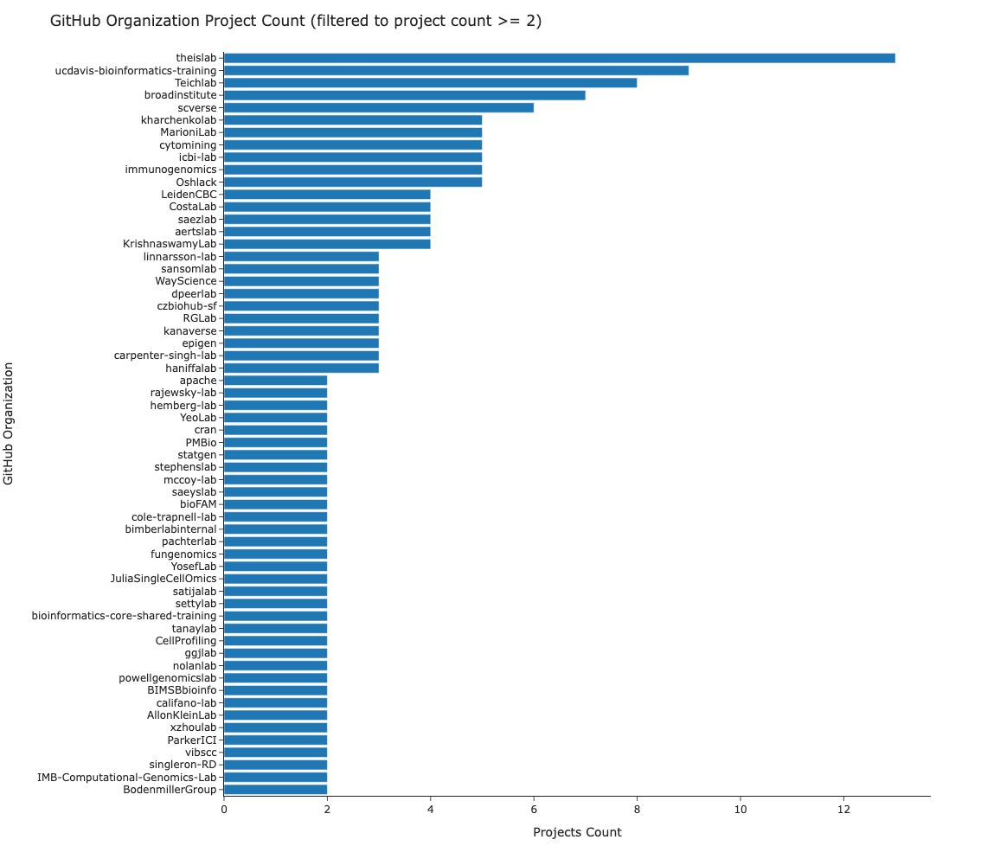

In [13]:
# gather project org data
df_project_orgs = df_projects["GitHub Organization"].value_counts()

# Create a horizontal bar chart using Plotly Express
fig_orgs = px.bar(
    df_project_orgs[df_project_orgs > 1].sort_values(ascending=True),
    orientation="h",
    width=1200,
    height=1000,
)

fig_orgs.update_layout(
    title="GitHub Organization Project Count (filtered to project count >= 2)",
    xaxis_title="Projects Count",
    showlegend=False,
    yaxis=dict(
        tickmode="array",
        tickvals=df_project_orgs.index.tolist(),
        ticktext=df_project_orgs.index.tolist(),
    ),
)

fig_collection.append(
    {
        "plot": fig_orgs,
        "description": """
        This plot shows the count of projects per GitHub organization (a collection of repositories)
        for those organizations with more than 2 projects.
        """,
        "findings": """
        Here we find that the Theis Lab, UC Davis Bioinformatics Training, and Teich Lab are at the top of this listing.
        """,
        "section": "General landscape",
    }
)

# Show the plot
fig_orgs.show()

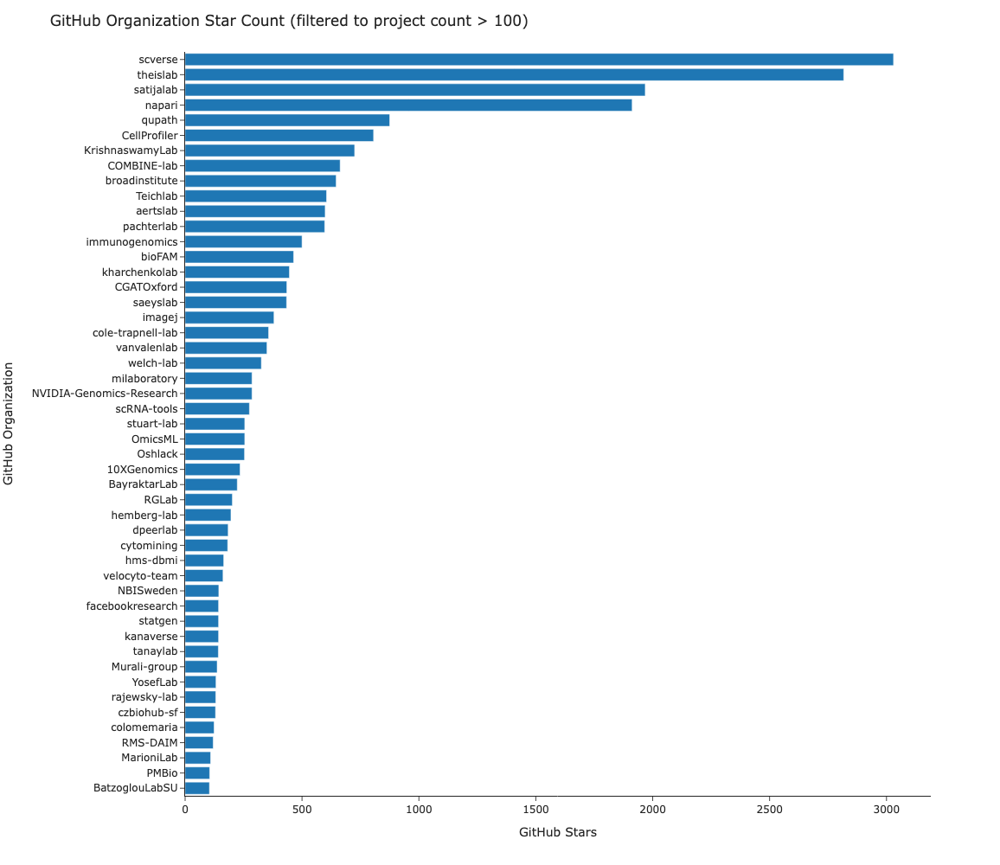

In [14]:
# gather project org data
df_project_orgs_stars = (
    df_projects[df_projects["category"] != "relevant-open-source"]
    .groupby(by=["GitHub Organization"])["GitHub Stars"]
    .sum()
)

# Create a horizontal bar chart using Plotly Express
fig_orgs_stars = px.bar(
    df_project_orgs_stars[df_project_orgs_stars > 100].sort_values(ascending=True),
    orientation="h",
    width=1200,
    height=1000,
)

fig_orgs_stars.update_layout(
    title="GitHub Organization Star Count (filtered to project count > 100)",
    xaxis_title="GitHub Stars",
    showlegend=False,
    yaxis=dict(
        tickmode="array",
        tickvals=df_project_orgs_stars.index.tolist(),
        ticktext=df_project_orgs_stars.index.tolist(),
    ),
)

fig_collection.append(
    {
        "plot": fig_orgs_stars,
        "description": """
        This plot shows the sum of GitHub stars per GitHub organization for those with a sum total of stars greater than 100.
        """,
        "findings": """
        Here we can observe that scverse, Theis Lab, and Satija Lab organizations hold the top count of GitHub stars.
        """,
        "section": "General landscape",
    }
)

# Show the plot
fig_orgs_stars.show()

In [15]:
# create a ydata_profiling profile
profile = ProfileReport(df_projects, title=f"{title_prefix}: Data Profile")
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [16]:
profile.to_file(f"{export_dir}/data_profile.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [17]:
# organize figures by their sections and the order in which they appeared in this notebook
fig_collection_grouped = {
    key: [
        {
            "plot": entry["plot"],
            "description": entry["description"],
            "findings": entry["findings"],
        }
        for entry in group
    ]
    for key, group in itertools.groupby(fig_collection, key=lambda x: x["section"])
}
fig_collection_grouped.keys()

dict_keys(['User base', 'Maturity', 'Usage', 'General landscape'])

In [18]:
cdn_included = False
with open(f"{export_dir}/report.html", "w") as f:
    f.write(
        """
<html>
<!-- referenced with modifications from example work on: https://github.com/KrauseFx/markdown-to-html-github-style -->

<head>
    <title>Cytomining Ecosystem | Way Lab: Software Landscape Analysis</title>
    <meta name="viewport" content="width=device-width, initial-scale=1">
    <meta charset="UTF-8">
    <link rel="stylesheet" href="../css/style.css">
</head>

<body>
    <div id='content'>
        <h1>Cytomining Ecosystem Software Landscape Analysis - Focused Report</h1>

        <p>This is a focused report to help describe landscape elements related to project user base size, usage,
        maturity, and general landscape for the Cytomining Ecosystem.</p>
        
        <p>Code related to this effort may be found at: <a
                href="https://github.com/WayScience/software-landscape-analysis">https://github.com/WayScience/software-landscape-analysis</a>.
        </p>
    """
    )

    for section, figures in fig_collection_grouped.items():
        f.write(f"<h2>{section}</h2>")
        f.write(f"<p>{section_descriptions[section]}</p>")
        f.write(f"<br><br>")
        for figure in figures:
            f.write(
                figure["plot"].to_html(
                    full_html=False,
                    include_plotlyjs="cdn" if not cdn_included else False,
                )
            )
            f.write(
                f"""
            <ul>
            <li><strong>Description:</strong> {figure['description']}</li>
            <li><strong>Findings:</strong> {figure['findings']}</li>
            </ul>
            """
            )
            cdn_included = True

    f.write(
        """
    <h2>Table with selected dataset columns</h2>
    <p>The table below may be used to search and view a selected number of columns from the dataset.</p>
    """
    )

    # write an itable to the page
    f.write(
        to_html_datatable(
            df_projects[
                [
                    "Project Name",
                    "Project Repo URL",
                    "GitHub Stars",
                    "GitHub Forks",
                    "GitHub Subscribers",
                    "GitHub Open Issues",
                    "GitHub Contributors",
                    "Date Created",
                    "category",
                    "Primary language",
                ]
            ],
            style="height:600px;float:left;",
            classes="display",
            maxBytes=0,
        )
    )
    f.write("</body></html>")

In [19]:
# capture the html page as a png export as a backup

# allow for nested asyncio ops
nest_asyncio.apply()


# define function for pyppeteer to capture image
# see: https://github.com/pyppeteer/pyppeteer#examples
async def capture_screenshot(file_path, output_path):
    browser = await launch(headless=True)
    page = await browser.newPage()
    # set the size of the capture
    await page.setViewport({"width": 1400, "height": 8500})
    await page.goto(f"file://{file_path}")

    await page.screenshot({"path": output_path})
    await browser.close()


# Capture screenshot from html page
asyncio.get_event_loop().run_until_complete(
    capture_screenshot(
        file_path=pathlib.Path(f"{export_dir}/report.html").resolve(),
        output_path=f"{export_dir}/report.png",
    )
)